# 5. Gyakorlat: Mély $Q$-tanulás

In [17]:
%pip install torch
%pip install gym
%pip install pygame
%pip install tensorflow

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [18]:
# Könyvtárak
import os
import gym
import random
import warnings
import matplotlib
import numpy as np
from collections import deque
import matplotlib.pyplot as plt
from matplotlib import animation
from collections import namedtuple
from scipy.signal import fftconvolve

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# Konfigurációk
seed = 0
np.random.seed(seed)
random.seed(seed)
%matplotlib inline
matplotlib.rc('animation', html='jshtml')
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"
warnings.filterwarnings('ignore')

## Segédfüggvények

In [19]:
# Jeleneti változó inicializálása
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

# Képkockák lejátszása egymás után
def plot_animation(frames, repeat=True, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(fig, update_scene, fargs=(frames, patch), frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Mozgóátlagolás (gyors Fourier-transzformáció konvolúcióval)
def window_avg(lst, window_size):
    window_size = int(window_size)
    kernel = np.ones(window_size) / window_size
    return fftconvolve(lst, kernel, mode='valid')

# Gördülő átlagolás effektív implementációval
def rolling_avg(lst):
    lst_sum = np.cumsum(lst)
    lst_avg = lst_sum / (np.arange(len(lst)) + 1)
    return list(lst_avg)

# Állapot 1-hot kódolása (erre a diszkrét állapotok miatt van szükség - folytonos állapotok esetén nem szükséges)
def encode_state(s, n_obs):
    result = np.zeros(n_obs)
    result[s] = 1
    return result

---
## $Q$-hálózat az ügynökhöz

In [20]:
class QNetwork(nn.Module):
    def __init__(self, state_size, action_size):  # Architektúra definíció
        super(QNetwork, self).__init__()
        self.fc1 = nn.Linear(state_size, 64)  # Input réteg (teljesen becsatolt)
        self.fc2 = nn.Linear(64, 32)  # Rejtett réteg (teljesen becsatolt)
        self.fc3 = nn.Linear(32, 16)  # Rejtett réteg (teljesen becsatolt)
        self.fc4 = nn.Linear(16, action_size)  # Output réteg (teljesen becsatolt)
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.to(self.device)
        
    def forward(self, s):  # Előrecsatolási csővezeték
        x = self.fc1(s)  # Első rétegen áramoltatás
        x = F.relu(x)  # Első réteg aktivációs függvénye (ReLu)
        x = self.fc2(x)
        x = F.relu(x)
        x = self.fc3(x)
        x = F.relu(x)
        x = self.fc4(x)
        return x

---
## Tapasztalat visszajátszás az ügynökhöz

In [21]:
class ReplayBuffer:
    def __init__(self, buffer_size, batch_size):
        self.batch_size = batch_size
        self.memory = deque(maxlen=buffer_size)
        self.experience = namedtuple("Experience", field_names=["state", "action", "reward", "next_state", "done"])  # Nevesített tömb típus létrehozása
    
    def add(self, state, action, reward, next_state, done):
        e = self.experience(state, action, reward, next_state, done)  # Egy nevesített tömb létrehozása a megkapott paraméterekkel
        self.memory.append(e)
    
    def sample(self):
        experiences = random.sample(self.memory, k=self.batch_size)  # Véletlen minta a memóriából

        # A véletlen minta átalakítása
        states = torch.from_numpy(np.vstack([e.state for e in experiences if e is not None])).float()
        actions = torch.from_numpy(np.vstack([e.action for e in experiences if e is not None])).long()
        rewards = torch.from_numpy(np.vstack([e.reward for e in experiences if e is not None])).float()
        next_states = torch.from_numpy(np.vstack([e.next_state for e in experiences if e is not None])).float()
        dones = torch.from_numpy(np.vstack([e.done for e in experiences if e is not None]).astype(np.uint8)).float()
  
        return states, actions, rewards, next_states, dones

    def __len__(self):  # Ha a __len__ függvény definiálva van le lehet kérdezni a struktúra hosszát a len() függvénnyel
        return len(self.memory)

---
## Ügynökök

In [22]:
class Agent():
    def __init__(self, alpha, gamma, state_size, action_size, buffer_size, batch_size, tau, update_every = 4):
        # Belső paraméterek
        self.t_step = 0
        self.alpha = alpha  # Tanulási sebesség
        self.gamma = gamma  # Diszkont faktor
        self.batch_size = batch_size  # Kötegméret a tanuláshoz (ekkora mintát fog venni az ügynök a tapasztalat visszajátszásból)
        self.action_size = action_size  # Lehetséges cselekvések száma (ekkora lesz a Q-hálózat output rétege)
        self.buffer_size = buffer_size  # Buffer méret (összesen ennyi rekord lesz a tapasztalat memóriában)
        self.update_every = update_every  # Ennyi tanítási iterációnként fog történni egy tanítási lépés
        # Hálózat és belső memória
        self.qnetwork_local = QNetwork(state_size, action_size)  # Q-hálózat lokális
        self.qnetwork_target = QNetwork(state_size, action_size)  # Q-hálózat cél
        self.optimizer = optim.Adam(self.qnetwork_local.parameters(), lr=alpha)  # Optimalizáló algoritmus
        self.memory = ReplayBuffer(buffer_size, batch_size)  # Tapasztalat memória
        self.network_name = 'FrozenLake_DQN.pth'  # Fájlnév a modell fájlhoz
        # Követési struktúrák
        self.mse_track = []  # MSE hiba követése
        self.action_stack = np.zeros((0, 2))  # Cselekvések követése
        self.state_action_stack = np.zeros((0, action_size))  # Állapotok követése
        self.tau = tau # Soft update paraméter
        self.learn_step_counter = 0 # Tanulási lépések számlálója


    def step(self, s, a, r, sp, done):
        self.memory.add(s, a, r, sp, done)  # A tapasztalat hozzáadása a tapasztalati memóriához
        self.action_stack = np.vstack([self.action_stack, np.array([a, r])])
        self.t_step = (self.t_step + 1) % self.update_every  # Ha elér 0-hoz akkor tanítási ciklus fog történni

        if self.t_step == 0 and len(self.memory) > self.batch_size:  # Ha az ügynök elért egy tanítási iterációt és van elég összegyűlt tapasztalat
            experiences = self.memory.sample()  # A tapasztalat memória véletlen mintázása
            self.learn(experiences)  # Tanulás a tapasztalattal

    def act(self, state, eps=0.):
        """Returns actions for given state as per current policy."""
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        state = torch.from_numpy(state).float().unsqueeze(0).to(device)
        self.qnetwork_local.eval()

        with torch.no_grad():
            action_values = self.qnetwork_local(state)

        self.qnetwork_local.train()

        # Epsilon-greedy action selection
        if random.random() > eps:
            return np.argmax(action_values.cpu().data.numpy())  # Choose the best action
        else:
            return random.choice(np.arange(self.action_size))  # Choose a random action

    def learn(self, experiences):
        states, actions, rewards, next_states, dones = experiences

        with torch.no_grad():
            # Double DQN update:
            local_max_actions = self.qnetwork_local(next_states).detach().argmax(1).unsqueeze(1)
            Q_targets_next = self.qnetwork_target(next_states).detach().gather(1, local_max_actions)

        # Compute the Q targets for current states using the Bellman equation
        Q_targets = rewards + (self.gamma * Q_targets_next * (1 - dones))

        # Get expected Q values from local model for the current batch
        Q_expected = self.qnetwork_local(states).gather(1, actions)

        # veszteség kiszámítása
        loss = F.mse_loss(Q_expected, Q_targets)
        self.mse_track.append(loss.item())

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        self.learn_step_counter += 1
        if self.learn_step_counter % self.update_every == 0:
            self.soft_update(self.qnetwork_local, self.qnetwork_target, self.tau)



    def save_network(self):
        torch.save(self.qnetwork_local.state_dict(), self.network_name) 
    
    def load_network(self):
        device = self.qnetwork_local.device
        self.qnetwork_local.load_state_dict(torch.load(self.network_name, map_location=device))
        self.qnetwork_target.load_state_dict(torch.load(self.network_name, map_location=device))

        
    def soft_update(self, local_model, target_model, tau):
        """Soft update model parameters."""
        for target_param, local_param in zip(target_model.parameters(), local_model.parameters()):
            target_param.data.copy_(tau*local_param.data + (1.0-tau)*target_param.data)



---
## Tanítás
### Paraméterek

Episode 100	Average Score: 0.00
Episode 200	Average Score: 0.00
Episode 300	Average Score: 0.00
Episode 400	Average Score: 0.01
Episode 500	Average Score: 0.00
Episode 600	Average Score: 0.00
Episode 700	Average Score: 0.00
Episode 800	Average Score: 0.00
Episode 900	Average Score: 0.01
Episode 1000	Average Score: 0.00
Episode 1100	Average Score: 0.00
Episode 1200	Average Score: 0.00
Episode 1300	Average Score: 0.00
Episode 1400	Average Score: 0.01
Episode 1500	Average Score: 0.00
Episode 1600	Average Score: 0.00
Episode 1700	Average Score: 0.00
Episode 1800	Average Score: 0.01
Episode 1900	Average Score: 0.00
Episode 2000	Average Score: 0.00
Episode 2100	Average Score: 0.01
Episode 2200	Average Score: 0.02
Episode 2300	Average Score: 0.00
Episode 2400	Average Score: 0.00
Episode 2500	Average Score: 0.00
Episode 2600	Average Score: 0.00
Episode 2700	Average Score: 0.00
Episode 2800	Average Score: 0.00
Episode 2900	Average Score: 0.01
Episode 3000	Average Score: 0.00
Episode 3100	Averag

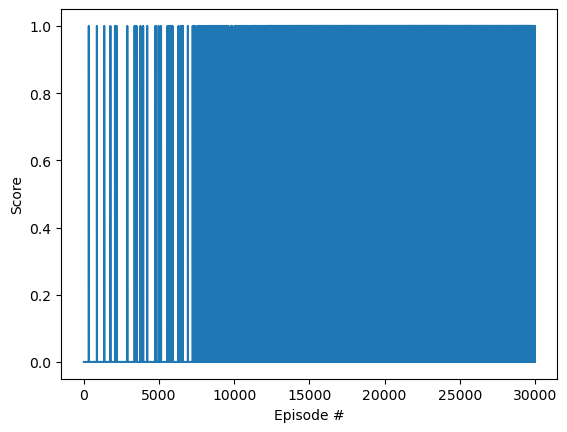

In [25]:
max_t = 100  # Maximális időlépés egyetlen epizódon belül
max_i = 30000  # Epizódok száma
gamma = 0.98  # Diszkontálási faktor
alpha = 5e-4  # Tanulási sebesség 
eps_end = 0.0  # Felfedezési ráta kezdőértéke
eps_start = 1.0  # Felfedezési ráta végértéke
eps_decay = 0.9999  # Felfedezési ráta iterációnként ennyivel fog csökkenni
batch_size = 64  # Kötegméret - tapasztalat visszajátszásból vett minta mérete
update_every = 4  # Milyen gyakran frissüljön a hálózat
window_size = 50  # Jutalmak átlagolási ablakának mérete 
buffer_size = 100000  # Tapasztalat visszajátszás maximális mérete
success_thresh = .7  # Sikeresnek mondható a tanítás ha efölé az érték főlé emelkedik az ablakos jutalom
tau = 1e-3  # Soft update paramétere

eps = eps_start  # Felfedezési ráta inicializálása
r_track = []  # Jutalmak követési struktúrája

env = gym.make(id = 'FrozenLake-v1', 
               desc = None, 
               map_name = "8x8", 
               is_slippery = True, 
               render_mode = 'rgb_array')  # Környezet

state_size = env.observation_space.n
action_size = env.action_space.n

agent = Agent(alpha = alpha, 
              gamma = gamma, 
              state_size = state_size, 
              action_size = action_size,
              buffer_size = buffer_size,
              batch_size = batch_size,
              update_every = update_every,
              tau=tau)  # Ügynök inicializálása

scores = []
scores_window = deque(maxlen=100)

for i_episode in range(1, max_i+1):
    state = encode_state(env.reset()[0], state_size)
    score = 0
    for t in range(max_t):
        action = agent.act(state, eps)
        next_state, reward, done, _ = env.step(action)[:4]
        next_state = encode_state(next_state, state_size)
        agent.step(state, action, reward, next_state, done)
        state = next_state
        score += reward
        if done:
            break
    scores_window.append(score)
    scores.append(score)
    eps = max(eps_end, eps_decay*eps)
    
    print('\rEpisode {}\tAverage Score: {:.2f}'.format(i_episode, np.mean(scores_window)), end="")
    if i_episode % 100 == 0:
        print('\rEpisode {}\tAverage Score: {:.2f}'.format(i_episode, np.mean(scores_window)))
    
    if np.mean(scores_window) >= success_thresh:
        print('\nEnvironment solved in {:d} episodes!\tAverage Score: {:.2f}'.format(i_episode-100, np.mean(scores_window)))
        agent.save_network()
        break

# plot the scores
fig = plt.figure()
ax = fig.add_subplot(111)
plt.plot(np.arange(len(scores)), scores)
plt.ylabel('Score')
plt.xlabel('Episode #')
plt.show()

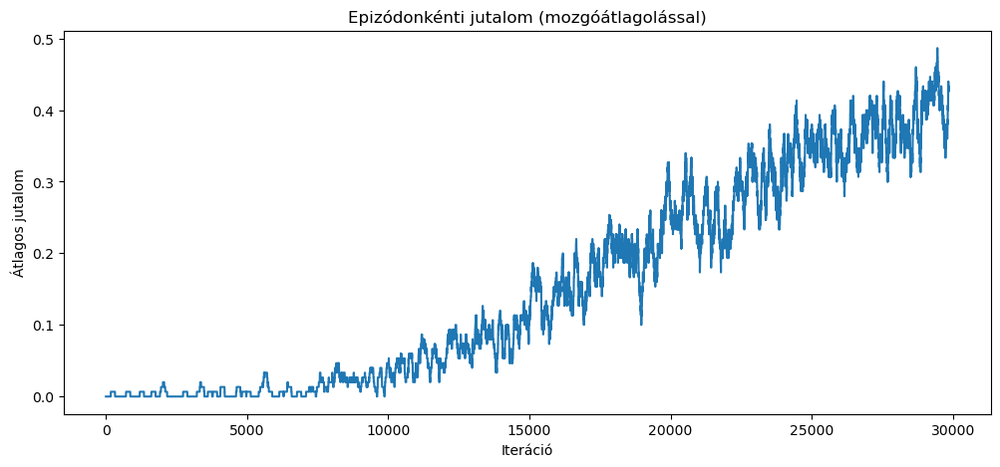

In [35]:
plt.figure(figsize=(12, 5))
plt.title('Epizódonkénti jutalom (mozgóátlagolással)')
plt.plot(window_avg(scores, len(scores) / 200))
plt.ylabel('Átlagos jutalom')
plt.xlabel('Iteráció')
plt.show()


Az algoritmus egyre jobban megtanulja, hogyan maximalizálja a jutalmat. Az iterációk száma növekedésével a jutalom ingadozásának mértéke változó lehet, de az általános tendencia mégis növekvő marad.

In [28]:
frames = []
done = False
s = encode_state(env.reset(seed=seed)[0], state_size)
while not done:
    a = agent.act(s, eps=0.0)
    sp, r, done, info, _ = env.step(a)
    sp = encode_state(sp, state_size)
    frames.append(env.render()) 
    s = sp

plot_animation(frames, repeat=True, interval=100)

Animation size has reached 21085666 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Dupla mély Q-tanulás elméleti háttér:
- dupla mély Q-tanulás (Double Deep Q-learning, DDQN) a mély Q-tanulás (DQN) kiterjesztése
- A DDQN algoritmusa a dupla Q-tanulás
elveit hajtja végre neurális hálózatokkal:
  - ebben az esetben a két Q-tábla helyett két Q-hálózat kap helyet az architektúrában:
    - Online hálózat Qθ: a cselekvések kiválasztásáért felel
    - Célhálózat Qθ¯: a választott cselekvés kiértékeléséért felel
- Az alapötlet az, hogy amikor frissítjük a becslő hálózat súlyait, a célfüggvény meghatározásához a célhálózatot használjuk.
- A online hálózatot használjuk az akció kiválasztására az új állapotban, de a jutalom becsléséhez a célhálózatot vesszük alapul -> csökken a túlbecsülési hiba
- Qtarget = r + γQ(s',argmaxa'Q(s', a';θ);θ-)
    ahol:
      - r a jutalom az adott lépésért,
      - γ a diszkontfaktor,
      - s' az új állapot a választott akció után,
      - a' az új állapotban választott akció,
      - θ a becslő hálózat paraméterei,
      - θ- a célhálózat paraméterei.